In [1]:
import os
import numpy as np
from subprocess import *
import sys
import h5py
import matplotlib.pyplot as pl
import lightcone_LAEinterface_decreasingz_xlos as lc
import matplotlib as mpl
import compute_ps_updated 
import angular_correlation_function as acf
from astropy.cosmology import z_at_value
from astropy.cosmology import WMAP9 as cosmo
import time
import xi_2D
import xi_3D
import LAE_Cluster as LAEC
cmap2 = mpl.colors.ListedColormap(['k', 'yellow'])
cmap3 = mpl.colors.ListedColormap(['k', 'white'])
pl.rcParams["font.family"] = "Times New Roman"
pl.rcParams['ytick.labelsize']=24
pl.rcParams['xtick.labelsize']=24
%load_ext autoreload
%autoreload 2
%matplotlib inline
start = 0.0
stop = 1
number_of_lines = 12
cm_subsection = np.linspace(start, stop, number_of_lines) 
cmap = pl.cm.Paired
cmap = cmap.reversed(pl.cm.Paired)
colors = [ cmap(x) for x in cm_subsection ]

path = '/users/michael/Research/PowerSpectrumNotebook/Boxes/'
def find_foldername(boxes_path , redshift, OUTPUT_NUMBER,  mode = 'some type'):
    #call(["echo looking for a " + str(mode) + " box at redshift " + str(redshift) ], shell = False )
    filename_list = open(boxes_path +'/filename_list_'+ str(mode) +'_' + str(OUTPUT_NUMBER) , 'w')
    call(["ls " + boxes_path + "*" + str(OUTPUT_NUMBER)], stdout = filename_list, shell = True)
    filename_list.close()
    with open(boxes_path + '/filename_list_' + str(mode) + '_' + str(OUTPUT_NUMBER), 'r') as inF:
        for line in inF:
            if mode in line and str(float(redshift)) in line and str(OUTPUT_NUMBER) in line:
                return  line.replace("\n", '')
            
def load_binary_data(filename, dtype=np.float32): 

    f = open(filename, "rb")
    data = f.read() 
    f.close() 
    _data = np.fromstring(data, dtype) 
    if sys.byteorder == 'big':
        _data = _data.byteswap()
    return _data

def box_maker(location):
    arr = load_binary_data(str(location))
    arr.shape = (HII_DIM,HII_DIM,HII_DIM)
    return arr.reshape((HII_DIM,HII_DIM,HII_DIM), order = 'F')

#new way of loading stuff
#name = 'xH_nohalos_z009.00_nf0.753192_Fstar0.0500_starPL0.5000_Fesc0.1000_escPL-0.5000_Mturn5.00e+08_HIIfilter1_RHIImax30_150_225Mpc_1337'
#data1 = np.fromfile(name ,dtype=np.float32)
#xH_data = data1.reshape((DIM,DIM,DIM))




('delta', 0.238732414637843)
('kmax', 3.6275987284684357)
('delta', 0.238732414637843)
('Rmax', 212.13203435596427)
('delta', 0.477464829275686)
('Rmax', 259.8076211353316)


In [107]:
HII_DIM = 200
DIM = 800
Box_length = 300
M_alpha_min = 1e10
N = 500
lya_min = 2.5e42
pixelsperslab = 25

#directory to get the ionization boxes (for lightcone and ionization fied and density field)
homo_io ='/Users/michael/Research/LAE_Clustering/Simulation_Boxes/MturnHaloes5e8_zeta25_MturnxHII5e8_beta1_fullEoR_Seed200_xLos_noHalos/'
homo_oi = '/Users/michael/Research/LAE_Clustering/Simulation_Boxes/MturnHaloes5e8_zeta25_MturnxHII5e8_beta-1_fullEoR_Seed200_xLos/'



In [20]:
#load the Halo Box at a SINGLE REDSHIFT, THE Z_END is only for the boundary of the integral for the lightcone


z_start, z_end, nboxes = 6.6, 6.0, 4
z_range = np.linspace(z_start, z_end, nboxes)
directory = '/Users/michael/Research/LAE_Clustering/Simulation_Boxes/MturnHaloes5e8_zeta25_MturnxHII5e8_beta1_fullEoR_Seed200_xLos/'
box = 'halos_z'+str(z_start)+'0_800_300Mpc_82600201'
halopos = np.genfromtxt(directory + box, dtype=None)

MichaelLAE = LAEC.LAE_Cluster(halopos, HII_DIM, DIM, Box_length)

There are 3896617 halos in this object


In [108]:
#make lightcone for each slice

#make the lightcone for each quantity
Luminosity_lightcone_Dictionary_insideout = {}
Luminosity_lightcone_Dictionary_outsidein = {}
Luminosity_densitylightcone_Dictionary_insideout = {}

for i in range(HII_DIM):
    #break
    box_slice = HII_DIM - i -1
    #if i%5 == 1:
    print('Doing box slice', box_slice)
    #box_slice = 187
    #densitylightcone_Dictionary_outsidein[int(box_slice)] = lc.lightcone(DIM = HII_DIM, z_start = z_start, z_end = z_end, N = 500, nboxes = nboxes, box_slice = int(box_slice), directory = homo_oi,  marker = 'updated_smoothed_deltax', sharp_cutoff = 50  )
    #lightcone_Dictionary_random[int(box_slice)] = lc.lightcone(DIM = HII_DIM, z_start = z_start, z_end = z_end, N = N, nboxes = nboxes, box_slice = int(box_slice), directory =  homo_random )
    Luminosity_lightcone_Dictionary_insideout[int(box_slice)] , lightcone_redshifts_io = lc.lightcone(DIM = HII_DIM, z_start = z_start, z_end = z_end, N = N, nboxes = nboxes, box_slice = int(box_slice), directory =  homo_io , sharp_cutoff = 20, return_redshifts = True)
    Luminosity_densitylightcone_Dictionary_insideout[int(box_slice)] = lc.lightcone(DIM = HII_DIM, z_start = z_start, z_end = z_end, N = N, nboxes = nboxes, box_slice = int(box_slice), directory = '/Users/michael/Research/LAE_Clustering/Simulation_Boxes/MturnHaloes5e8_zeta25_MturnxHII5e8_beta1_fullEoR_Seed200_xLos/' , marker = 'updated_smoothed_deltax' , sharp_cutoff = 20)
    Luminosity_lightcone_Dictionary_outsidein[int(box_slice)], lightcone_redshifts_oi = lc.lightcone(DIM = HII_DIM, z_start = z_start, z_end = z_end, N = N, nboxes = nboxes, box_slice = int(box_slice), directory =  homo_oi , sharp_cutoff = 20, return_redshifts = True)
        

        
        

('Doing box slice', 199)
('Doing box slice', 198)
('Doing box slice', 197)
('Doing box slice', 196)
('Doing box slice', 195)
('Doing box slice', 194)
('Doing box slice', 193)
('Doing box slice', 192)
('Doing box slice', 191)
('Doing box slice', 190)
('Doing box slice', 189)
('Doing box slice', 188)
('Doing box slice', 187)
('Doing box slice', 186)
('Doing box slice', 185)
('Doing box slice', 184)
('Doing box slice', 183)
('Doing box slice', 182)
('Doing box slice', 181)
('Doing box slice', 180)
('Doing box slice', 179)
('Doing box slice', 178)
('Doing box slice', 177)
('Doing box slice', 176)
('Doing box slice', 175)
('Doing box slice', 174)
('Doing box slice', 173)
('Doing box slice', 172)
('Doing box slice', 171)
('Doing box slice', 170)
('Doing box slice', 169)
('Doing box slice', 168)
('Doing box slice', 167)
('Doing box slice', 166)
('Doing box slice', 165)
('Doing box slice', 164)
('Doing box slice', 163)
('Doing box slice', 162)
('Doing box slice', 161)
('Doing box slice', 160)


In [104]:
#check whether the entire box satisfies the statistics of Andrei
#No EoR applied, and no slabs, if this worksm we'll perturb from there


MichaelLAE_wParams =  MichaelLAE.apply_parameters((1,1e10),  LAEpos = MichaelLAE.LAEpos)


MichaelLAE_wParams_wIO =  MichaelLAE.apply_reionization_slabs(Luminosity_lightcone_Dictionary_insideout , z_range, 1, 1, LAEpos = MichaelLAE_wParams, lightcone_redshifts = lightcone_redshifts_io, density =  Luminosity_densitylightcone_Dictionary_insideout)
MichaelLAE_wParams_wOI =  MichaelLAE.apply_reionization_slabs(Luminosity_lightcone_Dictionary_outsidein , z_range, 1, 1, LAEpos = MichaelLAE_wParams, lightcone_redshifts = lightcone_redshifts_io, density =  Luminosity_densitylightcone_Dictionary_insideout)
print('Total density is ' , str(MichaelLAE_wParams.shape[0]/(float(300**3))))

N, L_total_wIO  = MichaelLAE.extract_luminosities(LAEpos = MichaelLAE_wParams_wIO)
N, L_total_wOI  = MichaelLAE.extract_luminosities(LAEpos = MichaelLAE_wParams_wOI)
N, L_total  = MichaelLAE.extract_luminosities(LAEpos = MichaelLAE_wParams)



print('there are ' +  str(np.sum(N_total)) + ' LAEs in that box')

print('Densities:')
print('Inside-out : ' + str(MichaelLAE.density(LAEpos = MichaelLAE_wParams_wIO)))
print('Outside-in : ' +str(MichaelLAE.density(LAEpos = MichaelLAE_wParams_wOI)))
print('Total : ' + str(MichaelLAE.density(LAEpos = MichaelLAE_wParams)) )



there are 513276.0 LAEs in that box
Densities:
Inside-out : 0.00920033333333
Outside-in : 0.018312962963
Total : 0.0190102222222


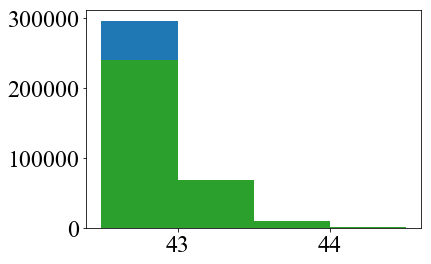

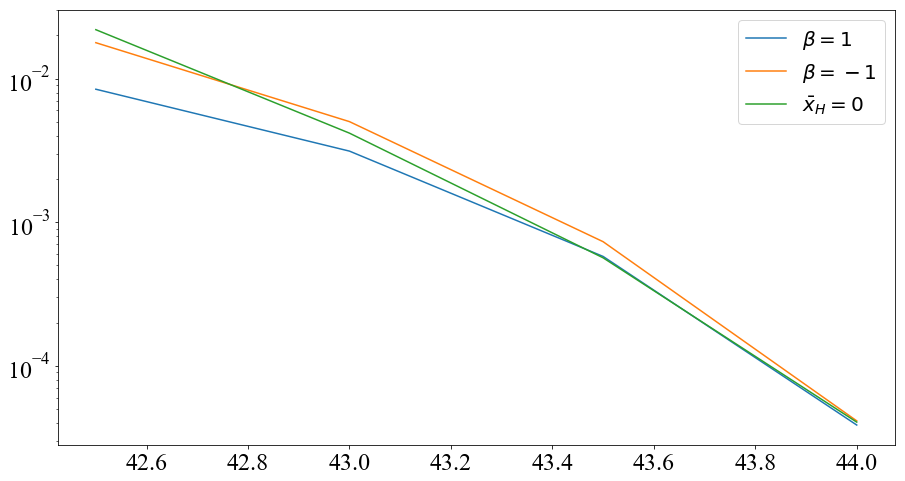

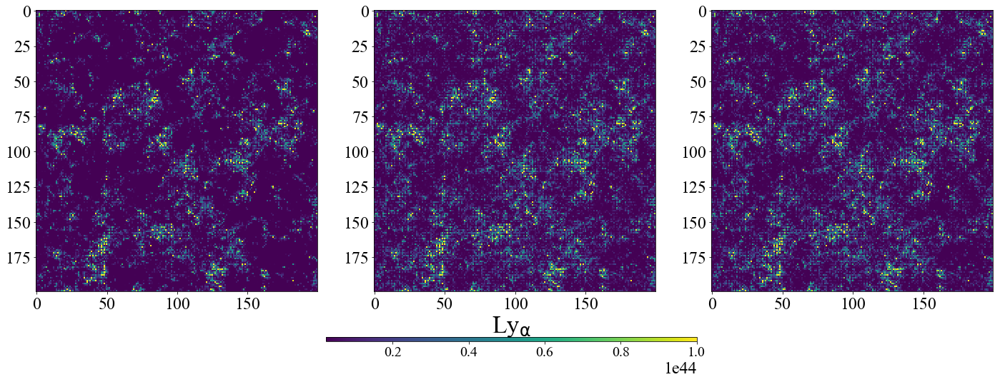

In [105]:
L_bins = np.round(np.linspace(42.5, 44, 15),1)
L_bins = (42.5, 43, 43.5, 44, 44.5)
n, bins , c = pl.hist( np.log10(L_total.flatten()[L_total.flatten() != 0]), bins = L_bins )
n_IO, bins_IO , c = pl.hist( np.log10(L_total_wIO.flatten()[L_total_wIO.flatten() != 0]), bins = L_bins )
n_OI, bins_OI , c = pl.hist( np.log10(L_total_wOI.flatten()[L_total_wOI.flatten() != 0]), bins =  L_bins )
pl.show()
pl.close()
    
pl.figure(figsize = (15,8))
pl.semilogy(bins[0:len(n)], n_IO*float(2)/float(300.*300.*300.), label = r'$\beta = 1$')
pl.semilogy(bins[0:len(n)], n_OI*float(2)/float(300.*300.*300.), label = r'$\beta = -1$')
pl.semilogy(bins[0:len(n)], n*float(2)/float(300.*300.*300.), label = r'$\bar{x}_H = 0$')
pl.legend(prop={'size': 20})
pl.show()
pl.close()


#put them into slabs
L_slabs_io = MichaelLAE.sort_into_slabs(slabs = 8, pixelsperslab = 25, LAEpos = MichaelLAE_wParams_wIO)
L_slabs_oi = MichaelLAE.sort_into_slabs(slabs = 8, pixelsperslab = 25, LAEpos = MichaelLAE_wParams_wOI)
L_slabs = MichaelLAE.sort_into_slabs(slabs = 8, pixelsperslab = 25, LAEpos = MichaelLAE_wParams)



#map them to a box
N_slabs_io, L_slabs_io = MichaelLAE.map_slab2box(LAEpos = L_slabs_io['7'])
N_slabs_oi, L_slabs_oi = MichaelLAE.map_slab2box(LAEpos = L_slabs_oi['7'])
N_slabs, L_slabs = MichaelLAE.map_slab2box(LAEpos = L_slabs['7'])
    
    

f, axarr = pl.subplots(1,3,figsize=(24, 8), sharex = True)
axarr[0].imshow(L_slabs_io, cmap = 'viridis', vmin = lya_min, vmax = 1e44)
axarr[1].imshow(L_slabs , cmap = 'viridis', vmin = lya_min, vmax = 1e44)
axarr[2].imshow(L_slabs_oi , cmap = 'viridis', vmin = lya_min, vmax = 1e44)
cb_ax = f.add_axes([0.36, 0.04, 0.30, 0.01])
cbar = f.colorbar(im3, cax = cb_ax, orientation = 'horizontal')
cb_ax.set_title(r'Ly$_{\rm \alpha}$', fontsize = '34', y = 1.1)
cbar.ax.tick_params(labelsize = '20')
pl.show()
pl.close()


#note to add to paper, you can still get bright luminosities with outside-in, even the underdense regions
#have large galaxies, just not many of them
#determine that
#and check to see that these aren't just bright galaxies in HI regions which are just scattered and reddended from IGM



In [ ]:







#This is the same analysis as above, but instead of looking at the total luminosity, here we are computing the
#luminosity function slice by slice

MichaelLAE_wParams_slabs = MichaelLAE.sort_into_slabs(slabs = 8, pixelsperslab = 25, LAEpos = MichaelLAE_wParams)
for i in range(8):
    Luminosities_per_slab = []
    Luminosities_per_slab.append(MichaelLAE.extract_luminosities(LAEpos = MichaelLAE_wParams_slabs[str(i)]))
    Luminosities_per_slab = np.array(Luminosities_per_slab)   
    
    #Box_Count_test, Box_Luminosity_test  = MichaelLAE.map_slab2box(LAEpos = MichaelLAE_wParams_slabs[str(i)])
    #pl.imshow(np.log(Box_Luminosity_test))
    #pl.show()
    #pl.close()


    a, b , c = pl.hist( np.log10((Luminosities_per_slab[0]) ), density = True ) 
    pl.show()
    pl.close()
    
    pl.semilogy(b[0:len(a)], np.true_divide( (a*Luminosities_per_slab.shape[1]), (300*300*Mpcperslab)))
    pl.show()
    pl.close()
    
    





/Users/michael/miniconda2/lib/python2.7/site-packages/ipykernel_launcher.py:49: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
/Users/michael/miniconda2/lib/python2.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in log10
  app.launch_new_instance()
/Users/michael/miniconda2/lib/python2.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: divide by zero encountered in log10
/Users/michael/miniconda2/lib/python2.7/site-packages/ipykernel_launcher.py:24: RuntimeWarning: divide by zero encountered in log10


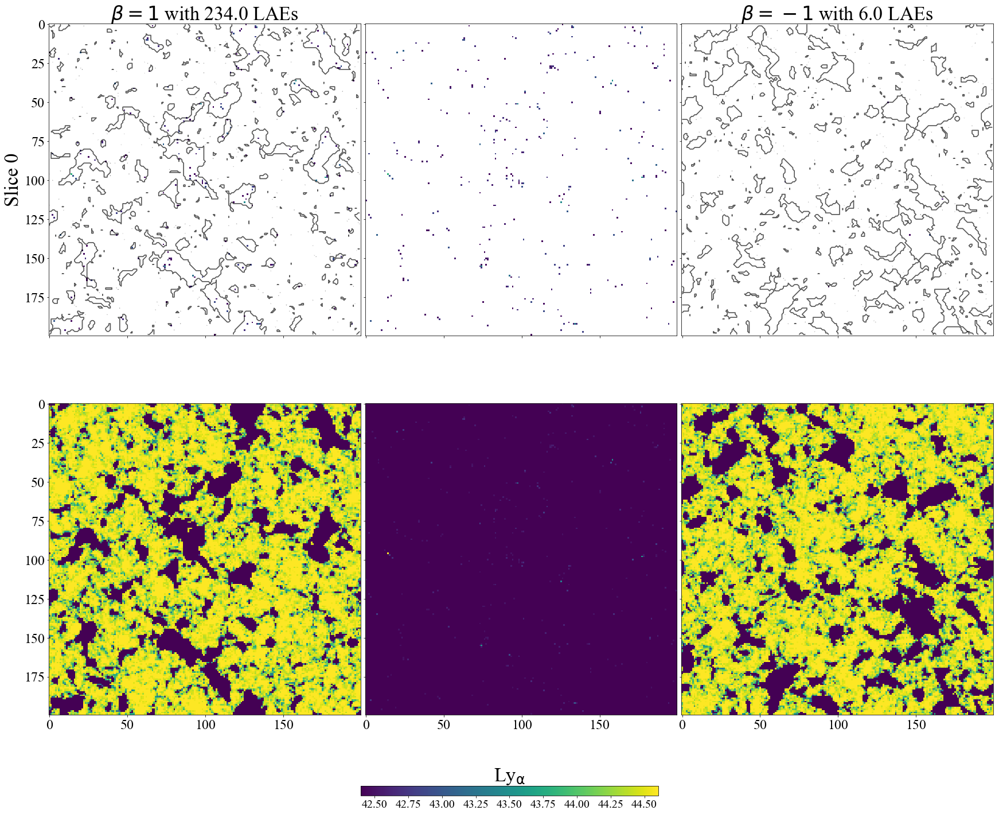

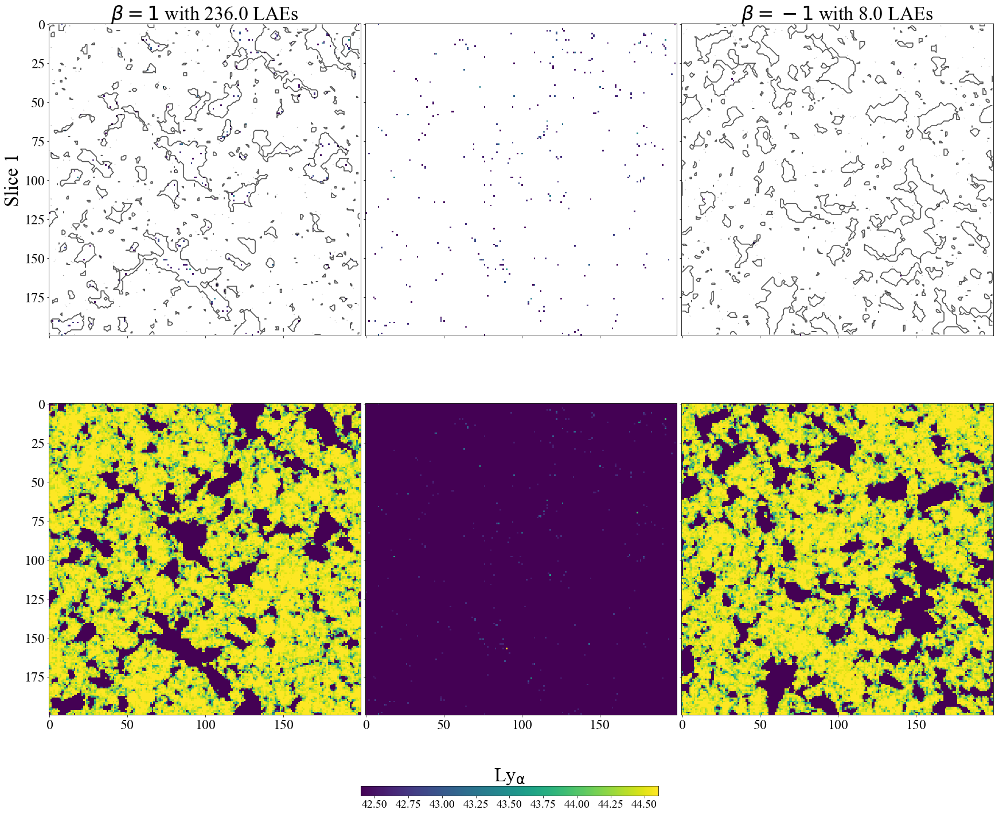

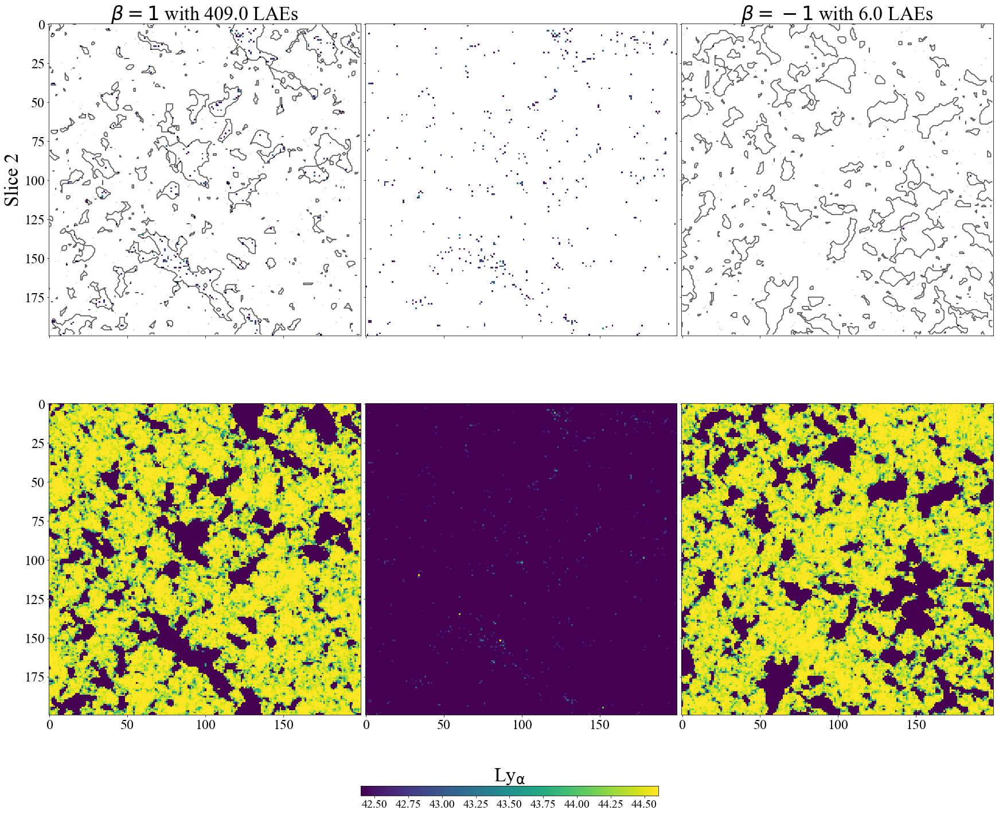

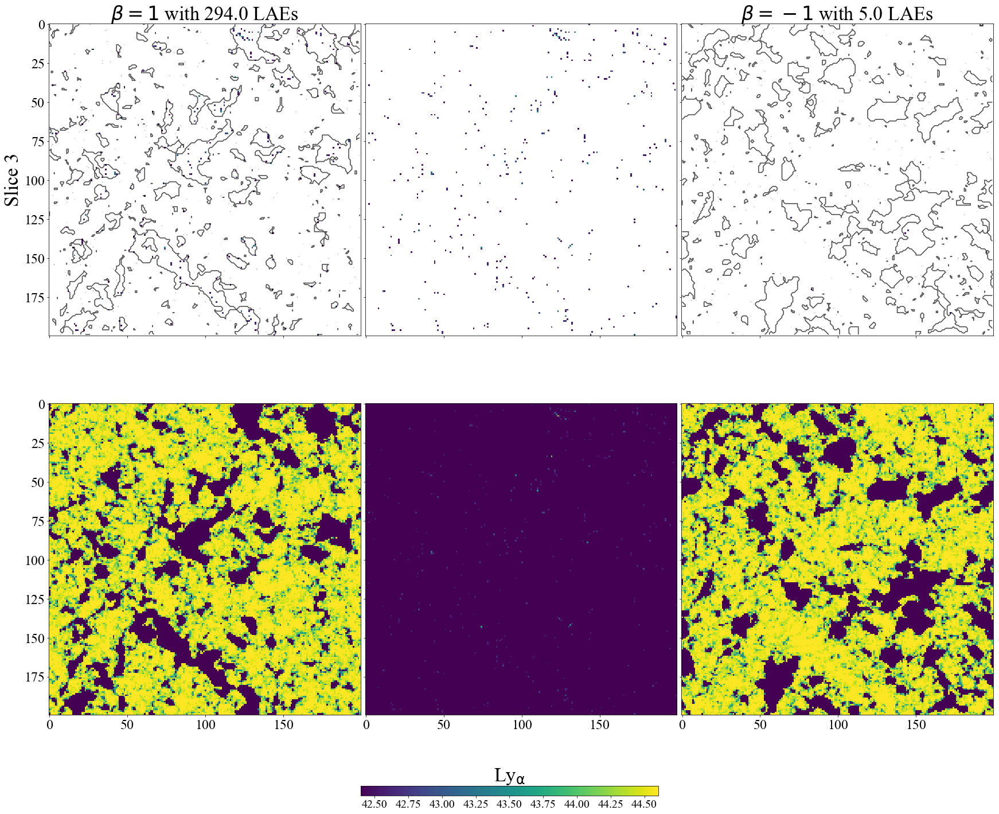

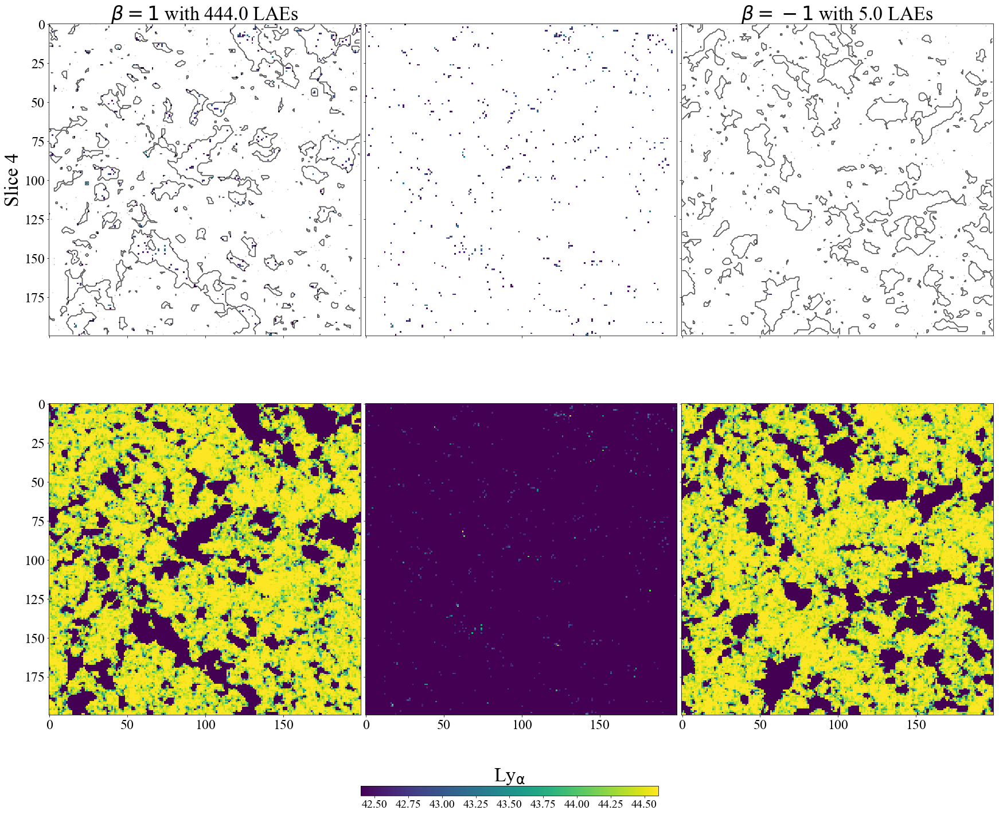

...

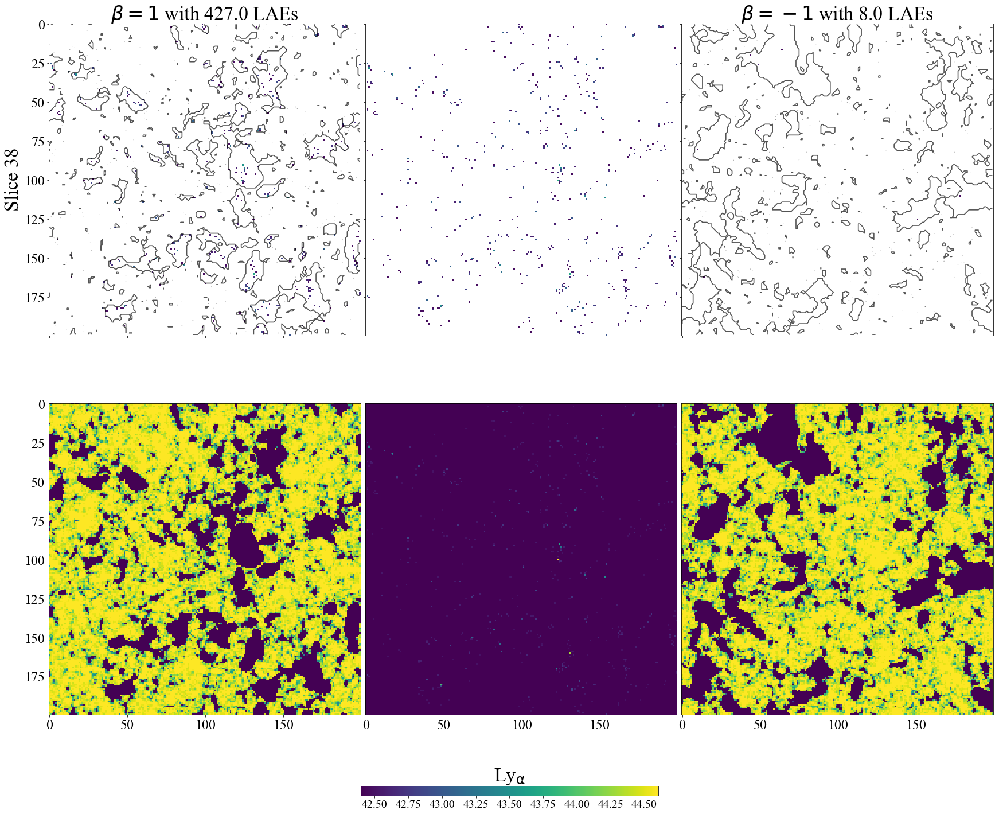

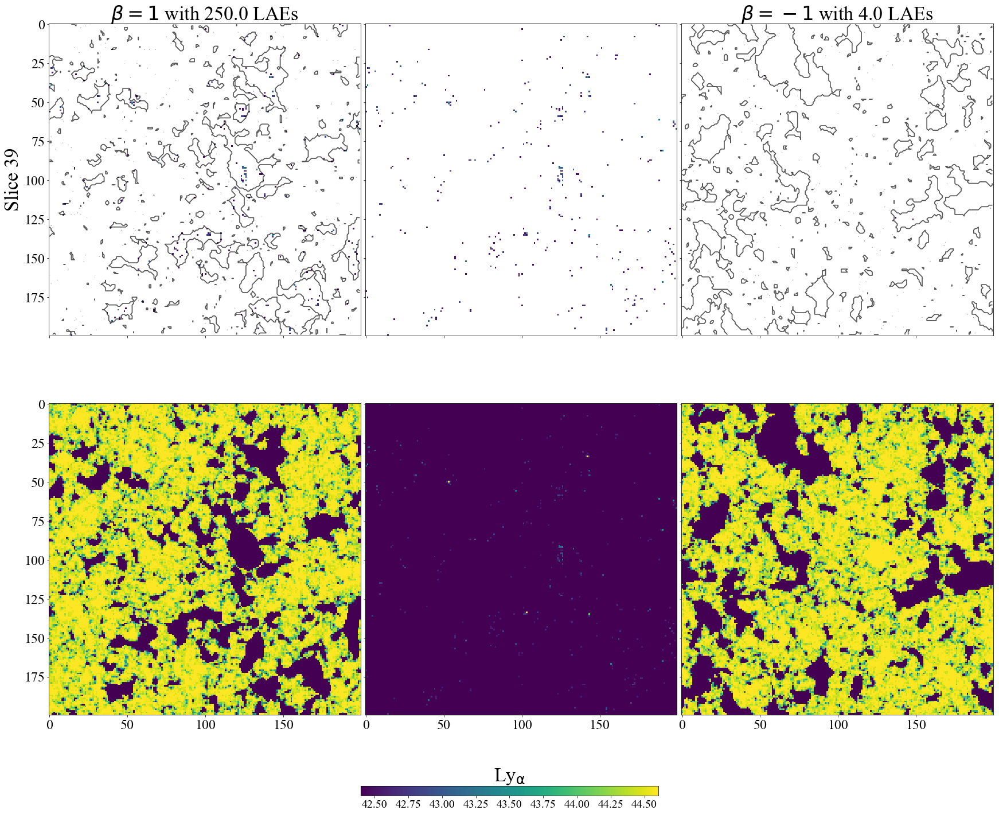

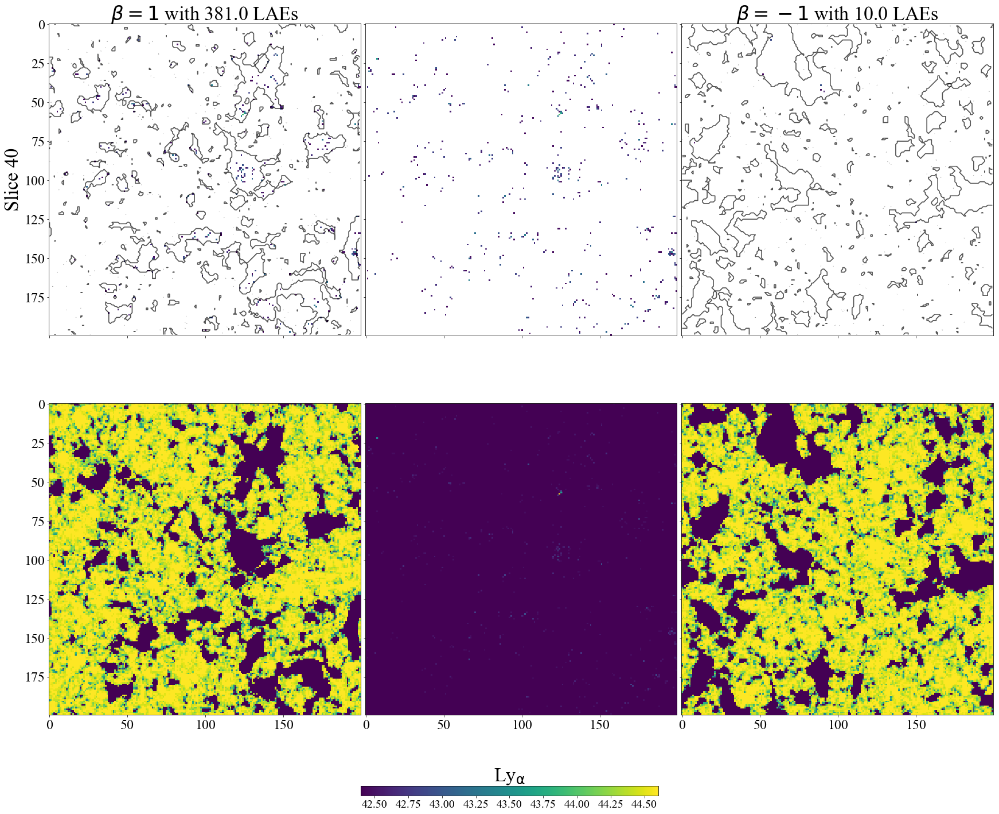

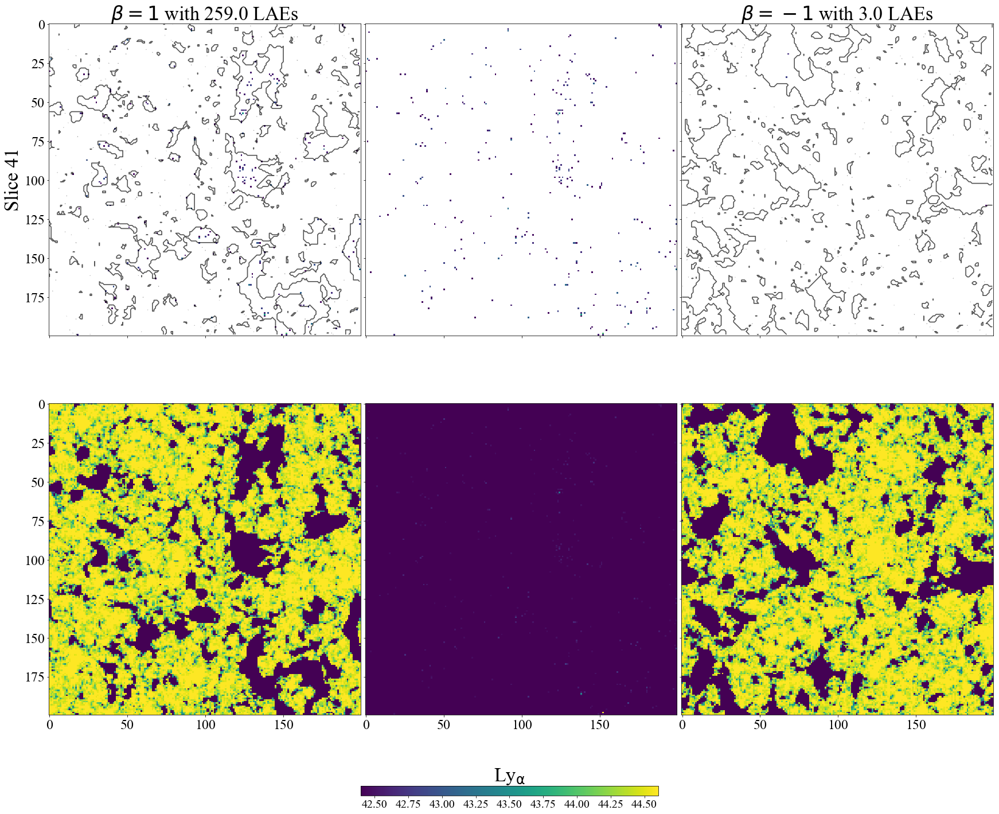

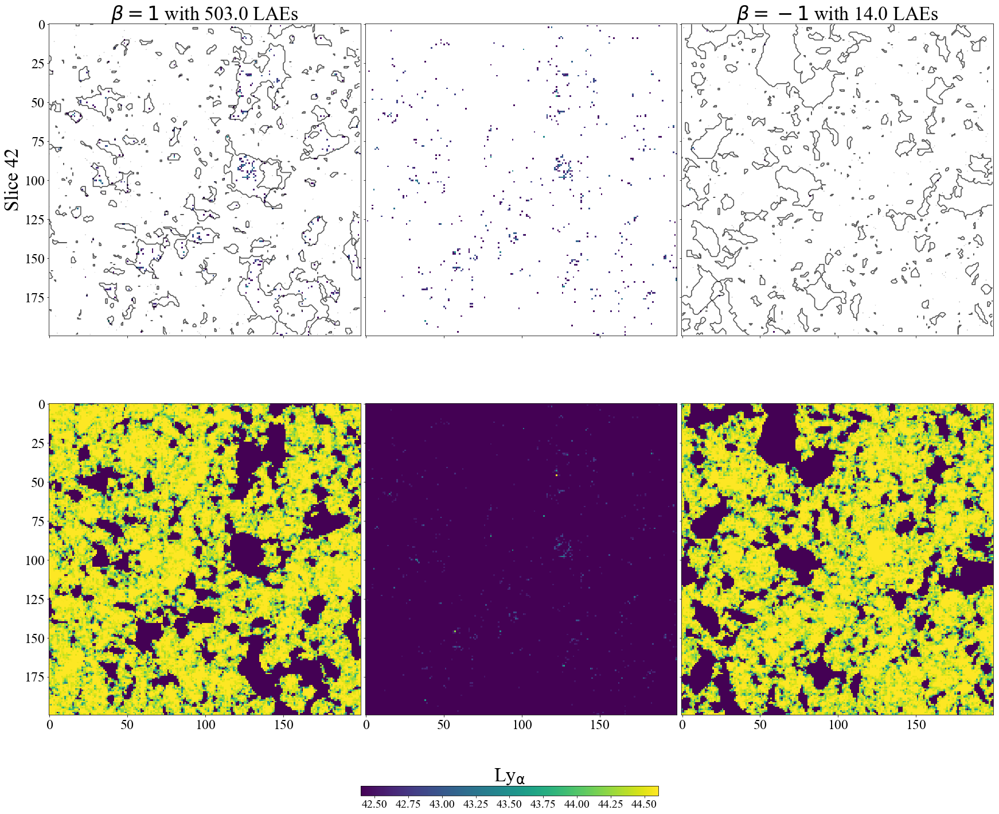

KeyboardInterrupt: 

In [51]:
#This is to look at the placement of the Halos and their luminsoities in configuration space
minval = np.log10(lya_min)
maxval = np.log10(4e44)

#load ionization boxes
xH_box_insideout = box_maker(find_foldername(homo_io, z_start, 82600201, mode = 'xH_' ))
xH_box_outsidein = box_maker(find_foldername(homo_oi, z_start, 51823861, mode = 'xH_' ))

for i in range(HII_DIM):    
        f, axarr = pl.subplots(2,3,figsize=(24, 24), sharex = True, sharey = True)
        
        #top left
        axarr[0,0].set_ylabel(r'Slice {}' .format(i), fontsize = 34)
        axarr[0,0].set_title(r'$\beta = 1$ with {} LAEs' .format(np.sum(N_total_wIO[i])), fontsize = 34)
        im2 = axarr[0,0].contour(xH_box_insideout[i], levels=np.logspace(-4.7, -3., 10), colors='black', alpha=0.1)
        im3 = axarr[0,0].imshow(np.log10(L_total_wIO[i]), cmap = 'viridis', vmin = minval, vmax = maxval)
        
        #top center
        im4 = axarr[0,1].imshow(np.log10(L_total[i]) , cmap = 'viridis', vmin = minval, vmax = maxval)
        
        #top right
        axarr[0,2].set_title(r'$\beta = -1$ with {} LAEs' .format(np.sum(N_total_wOI[i])), fontsize = 34)
        im2 = axarr[0,2].contour(xH_box_outsidein[i], levels=np.logspace(-4.7, -3., 10), colors='black', alpha=0.1)
        im5 = axarr[0,2].imshow(np.log10(L_total_wOI[i]) , vmin = minval, vmax = maxval)
       
        #bottom left
        im6 = axarr[1,0].imshow(xH_box_insideout[i])
        
        #bottom right
        im7 = axarr[1,2].imshow(xH_box_outsidein[i])
        
        #bottom center
        im8 = axarr[1,1].imshow(L_total[i])
        
        cb_ax = f.add_axes([0.36, 0.07, 0.30, 0.01])
        cbar = f.colorbar(im3, cax = cb_ax, orientation = 'horizontal')

        cb_ax.set_title(r'Ly$_{\rm \alpha}$', fontsize = '34', y = 1.1)
        #cb_density.set_title(r'$\delta$', fontsize = '34', y = 1.1)
        cbar.ax.tick_params(labelsize = '20')
        #cbar_density.ax.tick_params(labelsize = '29')
        
        f.tight_layout(pad = 0)
        pl.tight_layout(pad = 0)
        pl.show()
        pl.close()

In [67]:
#this is the same code as above, however instead of doing the luminosity function for the entire box 
#this part does the luminosity for a single slab. in this situation the lightcone need only be configured 
#for 25 slices. Also the code below this cell is purely only for plotting this
#So the Luminosity function of the entire box is consistent with andrei, and doesn't have the wiggles that this 
#single slab code does. We can compare the differences between the statistics of the entire box and just a single slab
#however right now, I want to know: does adding the luminosity of a single slab at redshift add any additional information
#to my MCMC. i.e. are the luminosity functions just scalar mulitples eachother with regard to beta
#or do they have different shape

slab = '7'

MichaelLAE_wParams_lowFduty =  MichaelLAE.apply_parameters((1,1e10),  LAEpos = MichaelLAE.LAEpos)
MichaelLAE_wParams_highFduty =  MichaelLAE.apply_parameters((1,1e11),  LAEpos = MichaelLAE.LAEpos)

MichaelLAE_wParams_slabs_lowFduty = MichaelLAE.sort_into_slabs(slabs = 8, pixelsperslab = pixelsperslab, LAEpos = MichaelLAE_wParams_lowFduty )
MichaelLAE_wParams_slabs_highFduty = MichaelLAE.sort_into_slabs(slabs = 8, pixelsperslab = pixelsperslab, LAEpos = MichaelLAE_wParams_highFduty )

MichaelLAE_wParams_wIO =  MichaelLAE.apply_reionization_slabs(Luminosity_lightcone_Dictionary_insideout , z_range, 1, 1, LAEpos = MichaelLAE_wParams_slabs_lowFduty[slab], lightcone_redshifts = lightcone_redshifts_io, density =  Luminosity_densitylightcone_Dictionary_insideout)
MichaelLAE_wParams_wOI =  MichaelLAE.apply_reionization_slabs(Luminosity_lightcone_Dictionary_outsidein , z_range, 1, 1, LAEpos = MichaelLAE_wParams_slabs_highFduty[slab], lightcone_redshifts = lightcone_redshifts_io, density =  Luminosity_densitylightcone_Dictionary_insideout)
print('Total density is ' , str(MichaelLAE_wParams.shape[0]/(float(37.5*300*300))))

L_total_wIO  = MichaelLAE.extract_luminosities(LAEpos = MichaelLAE_wParams_wIO)
L_total_wOI  = MichaelLAE.extract_luminosities(LAEpos = MichaelLAE_wParams_wOI)
L_total  = MichaelLAE.extract_luminosities(LAEpos = MichaelLAE_wParams_slabs[slab])



print('there are ' +  str(np.sum(N_total)) + ' LAEs in that box')

print('Densities:')
print('Inside-out : ' + str(MichaelLAE.density(LAEpos = MichaelLAE_wParams_wIO)))
print('Outside-in : ' +str(MichaelLAE.density(LAEpos = MichaelLAE_wParams_wOI)))
print('Total : ' + str(MichaelLAE.density(LAEpos = MichaelLAE_wParams)) )


('Total density is ', '0.152081777778')
there are 65841.0 LAEs in that box
Densities:
Inside-out : 0.00122396296296
Outside-in : 7.04074074074e-05
Total : 0.0190102222222


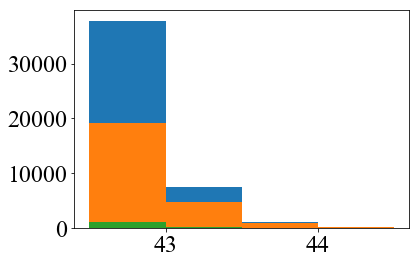

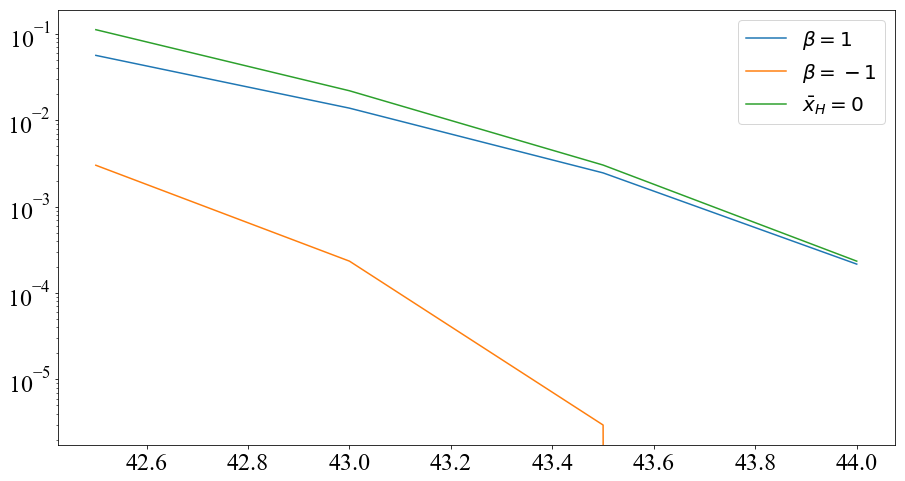

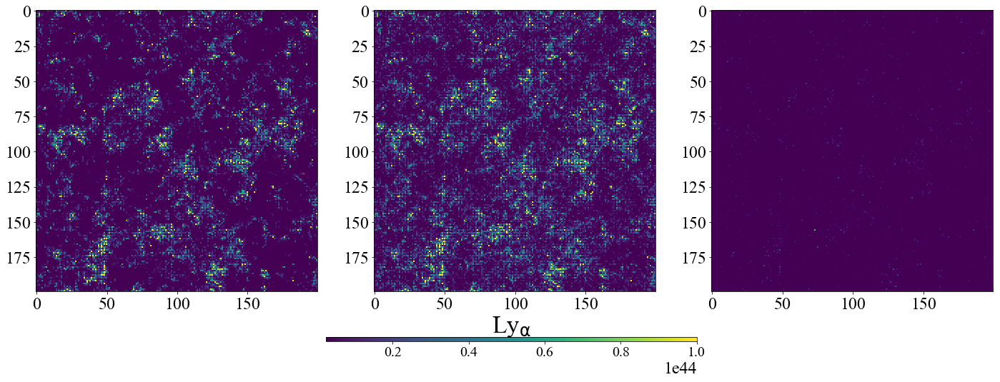

In [68]:
L_bins = np.round(np.linspace(42.5, 44, 15),1)
L_bins = (42.5, 43, 43.5, 44, 44.5)

n, bins , c = pl.hist( np.log10(L_total.flatten()[L_total.flatten() != 0]), bins = L_bins )
n_IO, bins_IO , c = pl.hist( np.log10(L_total_wIO.flatten()[L_total_wIO.flatten() != 0]), bins = L_bins )
n_OI, bins_OI , c = pl.hist( np.log10(L_total_wOI.flatten()[L_total_wOI.flatten() != 0]), bins = L_bins )
pl.show()
pl.close()
    
pl.figure(figsize = (15,8))
pl.semilogy(bins[0:len(n)], n_IO*float(10)/float(37.5*300*300), label = r'$\beta = 1$')
pl.semilogy(bins[0:len(n)], n_OI*float(10)/float(37.5*300*300), label = r'$\beta = -1$')
pl.semilogy(bins[0:len(n)], n*float(10)/float(37.5*300*300), label = r'$\bar{x}_H = 0$')
pl.legend(prop={'size': 20})
pl.show()
pl.close()


#put them into slabs
L_slabs_io = MichaelLAE.sort_into_slabs(slabs = 8, pixelsperslab = 25, LAEpos = MichaelLAE_wParams_wIO)
L_slabs_oi = MichaelLAE.sort_into_slabs(slabs = 8, pixelsperslab = 25, LAEpos = MichaelLAE_wParams_wOI)
L_slabs = MichaelLAE.sort_into_slabs(slabs = 8, pixelsperslab = 25, LAEpos = MichaelLAE_wParams)



#map them to a box
N_slabs_io, L_slabs_io = MichaelLAE.map_slab2box(LAEpos = L_slabs_io['7'])
N_slabs_oi, L_slabs_oi = MichaelLAE.map_slab2box(LAEpos = L_slabs_oi['7'])
N_slabs, L_slabs = MichaelLAE.map_slab2box(LAEpos = L_slabs['7'])
    
    

f, axarr = pl.subplots(1,3,figsize=(24, 8), sharex = True)
im1 = axarr[0].imshow(L_slabs_io, cmap = 'viridis', vmin = lya_min, vmax = 1e44)
im2 = axarr[1].imshow(L_slabs , cmap = 'viridis', vmin = lya_min, vmax = 1e44)
im3 = axarr[2].imshow(L_slabs_oi , cmap = 'viridis', vmin = lya_min, vmax = 1e44)
cb_ax = f.add_axes([0.36, 0.04, 0.30, 0.01])
cbar = f.colorbar(im2, cax = cb_ax, orientation = 'horizontal')
cb_ax.set_title(r'Ly$_{\rm \alpha}$', fontsize = '34', y = 1.1)
cbar.ax.tick_params(labelsize = '20')
pl.show()
pl.close()


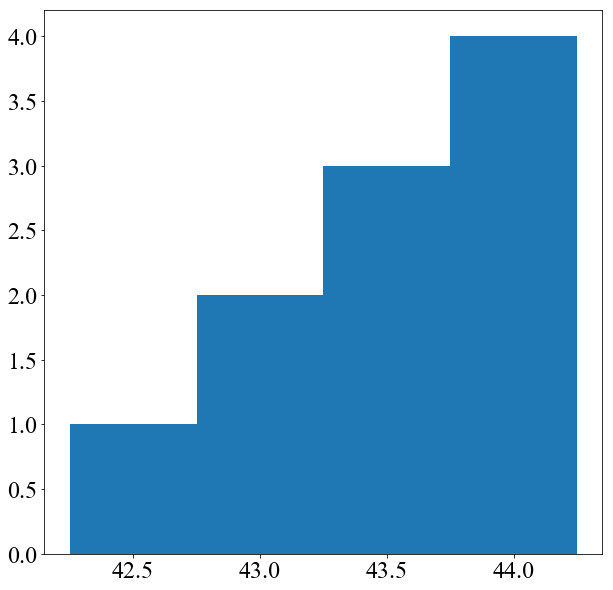

(array([42.5, 43. , 43.5, 44. , 44.5]), array([1., 2., 3., 4.]))


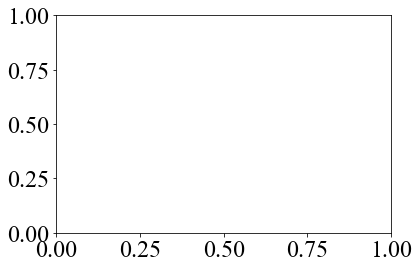

In [97]:
pl.figure(figsize = (10,10))
bins = (42.5, 43, 43.5, 44, 44.5)
arr = (42.5,  43,  43, 43.5, 43.5, 43.5, 44,44,44,44)
n, bins , d = pl.hist(arr, bins = bins, align = 'left')
pl.show()
pl.close()
pl.cla()
print(bins, n)